In [ ]:
#Mounting the google drive to copy and save required files
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
#installing dependencies
!pip install -U --pre triton
!pip install -U xformers
!pip install accelerate transformers datasets
!pip install bitsandbytes
!pip install diffusers
!pip install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu113
!pip install peft
!pip install tensorboard
!pip install safetensors

In [ ]:
#installing the latest version of diffusers to mitigate errors

!pip uninstall -y diffusers
!pip install git+https://github.com/huggingface/diffusers.git

In [ ]:
#upgrading the following libraries to mitigate errors
!pip install --upgrade transformers accelerate

In [ ]:
#downloading the LoRA traning script
!wget https://raw.githubusercontent.com/huggingface/diffusers/main/examples/text_to_image/train_text_to_image_lora.py

--2024-09-16 07:27:13--  https://raw.githubusercontent.com/huggingface/diffusers/main/examples/text_to_image/train_text_to_image_lora.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 40697 (40K) [text/plain]
Saving to: ‘train_text_to_image_lora.py.1’

train_text_to_image 100%[===================>]  39.74K  --.-KB/s    in 0.007s  

2024-09-16 07:27:13 (5.22 MB/s) - ‘train_text_to_image_lora.py.1’ saved [40697/40697]



In [ ]:
#logging into huggingface hub
from huggingface_hub import notebook_login
notebook_login()

In [ ]:
#This is the main training script

!accelerate launch --mixed_precision="no" --num_processes=1 --num_machines=1 --dynamo_backend="no" train_text_to_image_lora.py \
  --pretrained_model_name_or_path="CompVis/stable-diffusion-v1-4" \
  --dataset_name="yashvoladoddi37/kanjienglish" \
  --image_column="image" \
  --caption_column="text" \
  --resolution=512 \
  --random_flip \
  --train_batch_size=1 \
  --num_train_epochs=1 \
  --checkpointing_steps=500 \
  --learning_rate=1e-04 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=0 \
  --seed=42 \
  --output_dir="kanji-diffusion-v1-4" \
  --validation_prompt="A kanji meaning Elon Musk" \
  --report_to="tensorboard" \
  --logging_dir="logs"

2024-09-16 07:49:29.614024: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-16 07:49:29.633890: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-16 07:49:29.639911: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-16 07:49:29.654432: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-09-16 07:49:30.682077: W tensorflow/comp

In [ ]:
#using tensorboard to monitor the training curves

%load_ext tensorboard
%tensorboard --logdir /content/kanji-diffusion-v1-4/logs/text2image-fine-tune

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
  #zipping the saved checkpoints folder

  !zip -r /content/kanji-diffusion-v1-4-latest-checkpoint.zip /content/kanji-diffusion-v1-4/checkpoint-5000

  adding: content/kanji-diffusion-v1-4/checkpoint-5000/ (stored 0%)
  adding: content/kanji-diffusion-v1-4/checkpoint-5000/scheduler.bin (deflated 55%)
  adding: content/kanji-diffusion-v1-4/checkpoint-5000/optimizer.bin (deflated 8%)
  adding: content/kanji-diffusion-v1-4/checkpoint-5000/model.safetensors (deflated 7%)
  adding: content/kanji-diffusion-v1-4/checkpoint-5000/random_states_0.pkl (deflated 25%)
  adding: content/kanji-diffusion-v1-4/checkpoint-5000/pytorch_lora_weights.safetensors (deflated 6%)


In [ ]:
#saving the logs
!zip -r /content/kanji-diffusion-v1-4-logs.zip /content/kanji-diffusion-v1-4/logs

  adding: content/kanji-diffusion-v1-4/logs/ (stored 0%)
  adding: content/kanji-diffusion-v1-4/logs/text2image-fine-tune/ (stored 0%)
  adding: content/kanji-diffusion-v1-4/logs/text2image-fine-tune/1726473007.8319795/ (stored 0%)
  adding: content/kanji-diffusion-v1-4/logs/text2image-fine-tune/1726473007.8319795/hparams.yml (deflated 48%)
  adding: content/kanji-diffusion-v1-4/logs/text2image-fine-tune/events.out.tfevents.1726473007.8ab7a8c9a815.10722.0 (deflated 8%)
  adding: content/kanji-diffusion-v1-4/logs/text2image-fine-tune/1726473007.8303823/ (stored 0%)
  adding: content/kanji-diffusion-v1-4/logs/text2image-fine-tune/1726473007.8303823/events.out.tfevents.1726473007.8ab7a8c9a815.10722.1 (deflated 52%)


In [ ]:
#saving the checkpoint in my drive for permanent storage
!cp /content/kanji-diffusion-v1-4-latest-checkpoint.zip /content/drive/MyDrive/

In [ ]:
#Loading the pre-trained Stable Diffusion model and moving it to GPU for efficient processing.
from diffusers import StableDiffusionPipeline
import torch

model_id = "CompVis/stable-diffusion-v1-4"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to("cuda")

In [ ]:
# Load and apply LoRA weights
lora_model_path = "/content/kanji-diffusion-v1-4/pytorch_lora_weights.safetensors"
pipe.unet.load_attn_procs(lora_model_path)

In [ ]:
# Defines a function to generate and display images based on text prompts
def generate_image(prompt, num_images=1):
    images = pipe(prompt, num_images_per_prompt=num_images).images
    for i, image in enumerate(images):
        display(image)
        image.save(f"generated_image_{i}.png")

  0%|          | 0/50 [00:00<?, ?it/s]

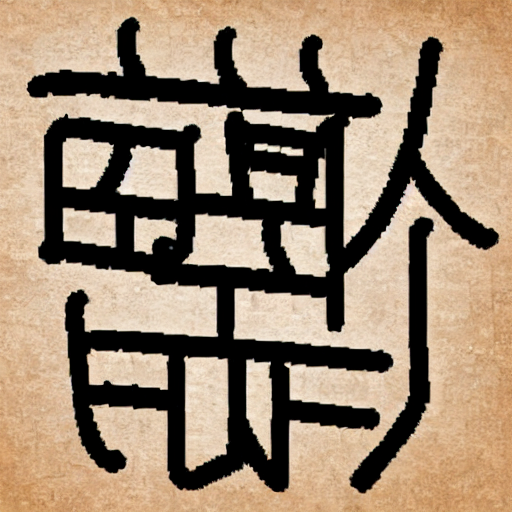

In [ ]:
prompt = "a kanji meaning transformers"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

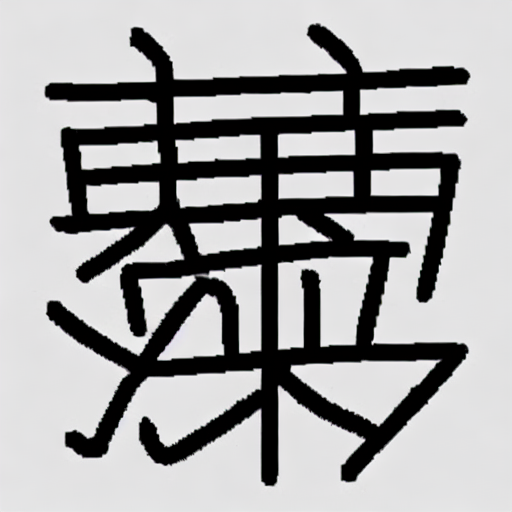

In [ ]:
prompt = "a kanji meaning fire"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

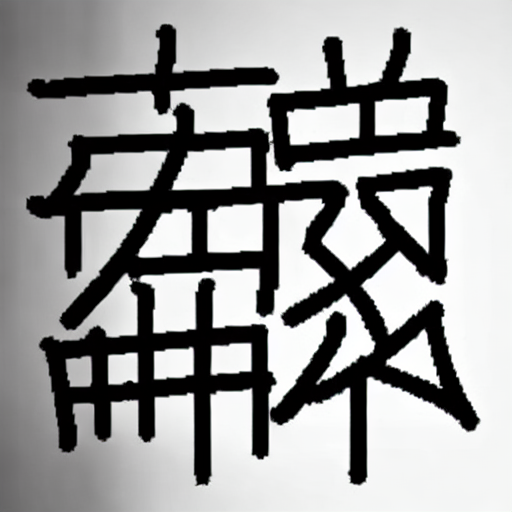

In [ ]:
prompt = "a kanji meaning Ghost"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

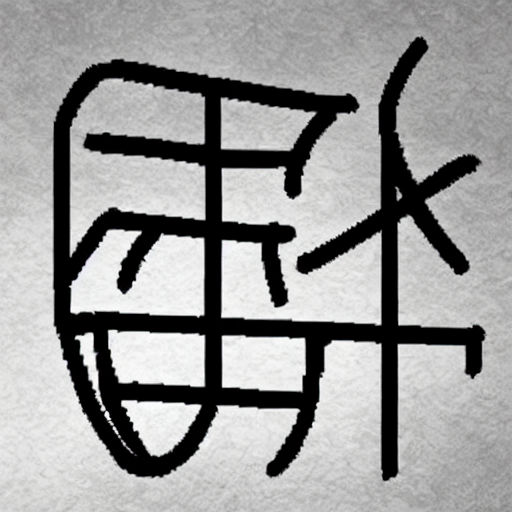

In [ ]:
prompt = "a kanji meaning Assassin's Creed"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

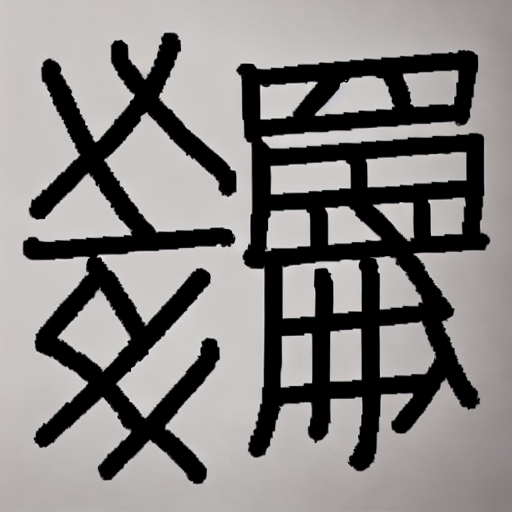

In [ ]:
prompt = "a kanji meaning Youtube"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

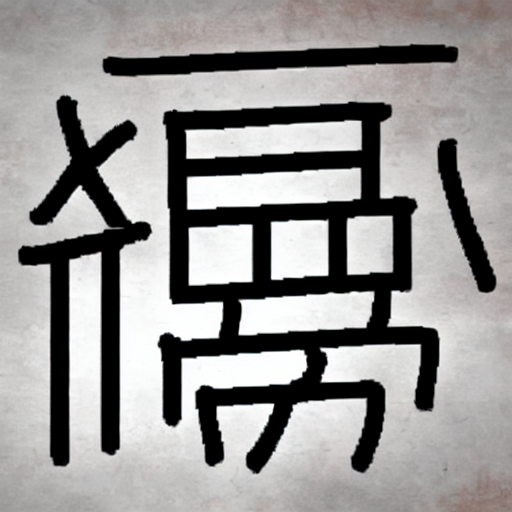

In [ ]:
prompt = "a kanji meaning Elon Musk"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

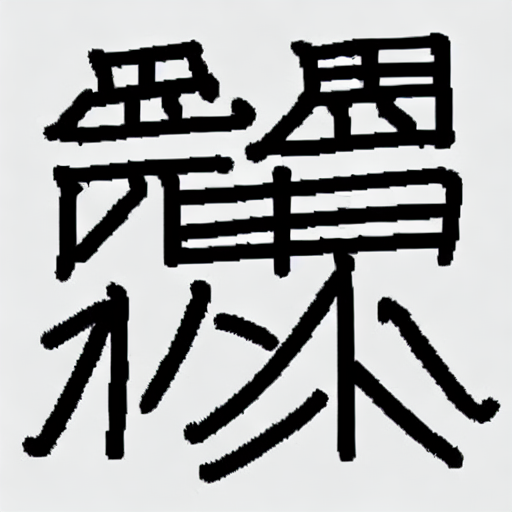

In [ ]:
prompt = "a kanji meaning Super Mario"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

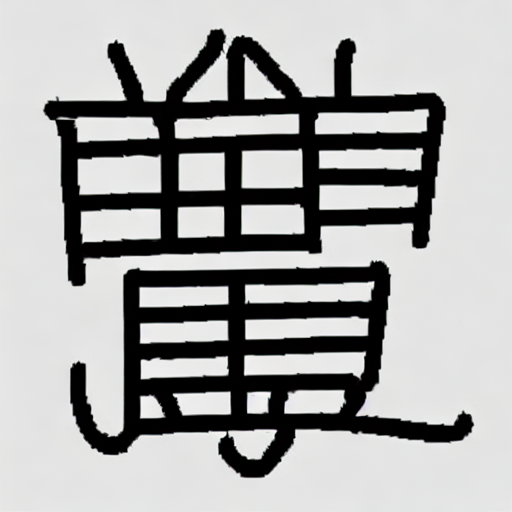

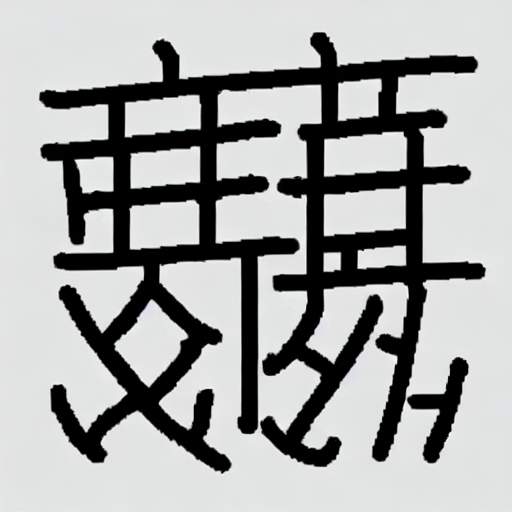

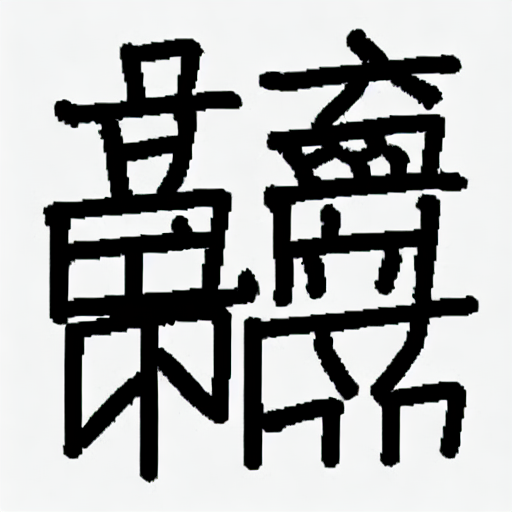

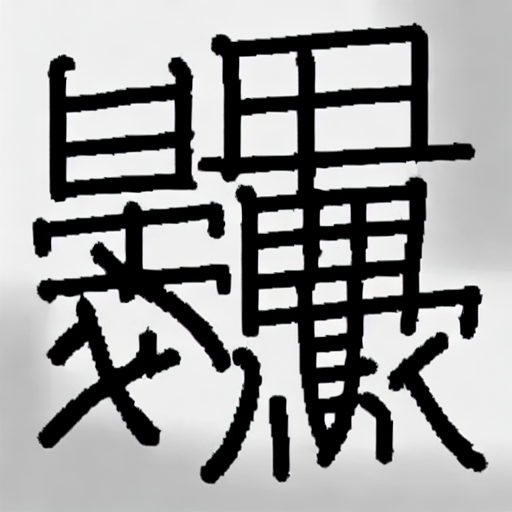

In [ ]:
prompt = "a kanji meaning Iron Man"
generate_image(prompt, num_images=4)

  0%|          | 0/50 [00:00<?, ?it/s]

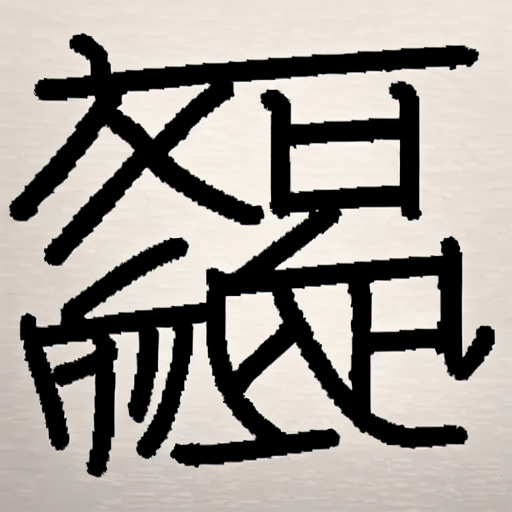

In [ ]:
prompt = "a kanji meaning Spiderman (white background)"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

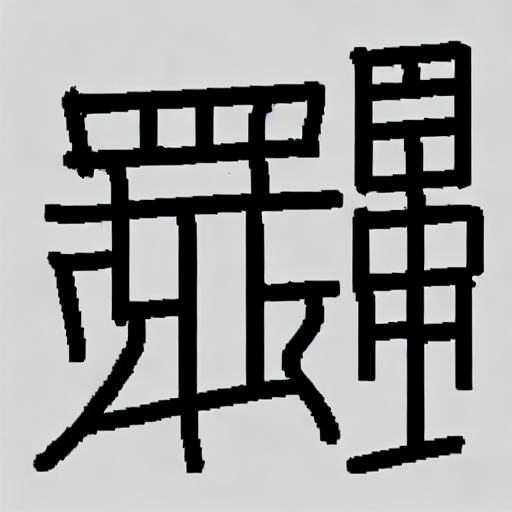

In [ ]:
prompt = "a kanji meaning linux"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

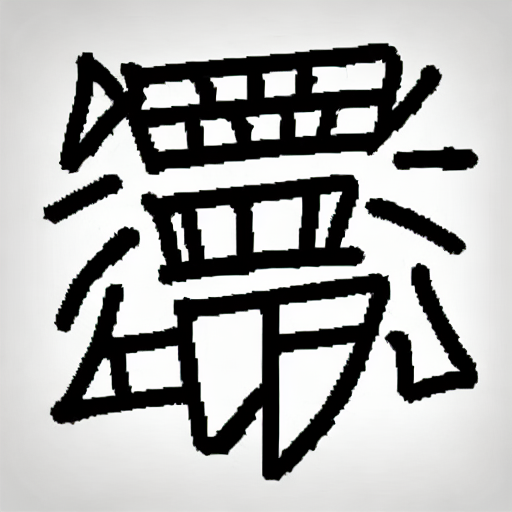

In [ ]:
prompt = "a kanji meaning cute teddy bear (white background)"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

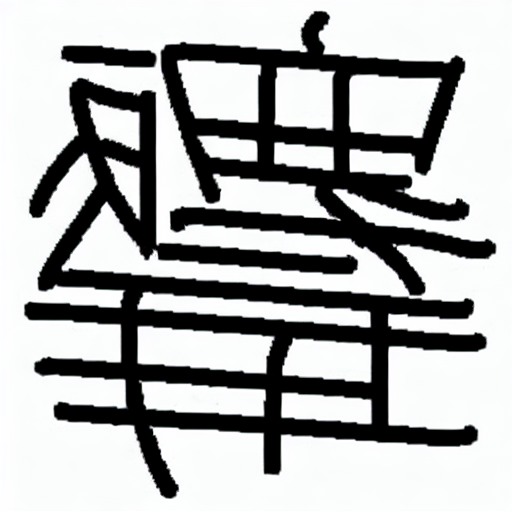

In [ ]:
prompt = "a kanji meaning water"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

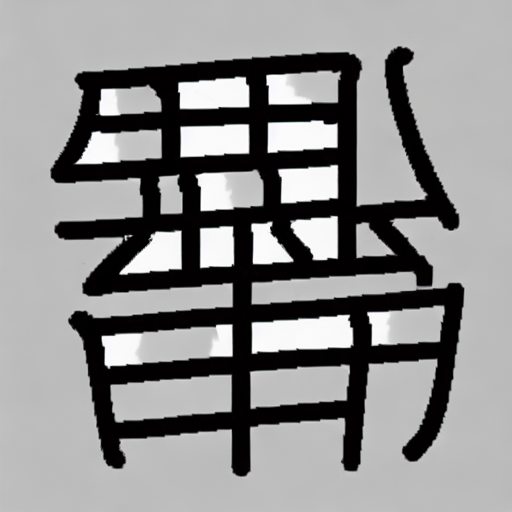

In [ ]:
prompt = "a kanji meaning stars"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

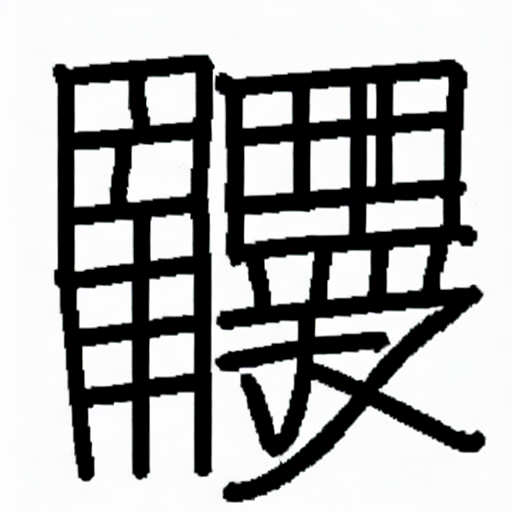

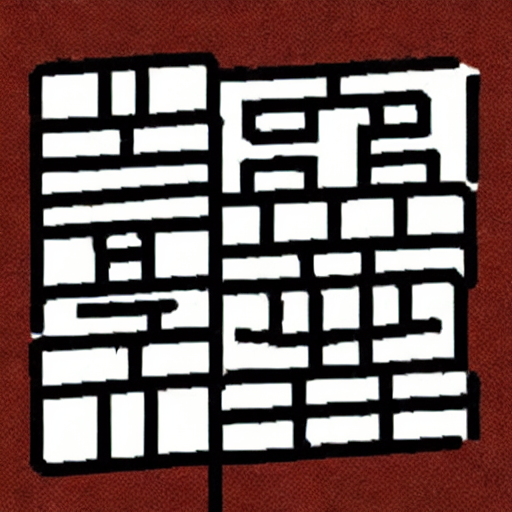

In [ ]:
prompt = "a kanji meaning sushi"
generate_image(prompt, num_images=2)

  0%|          | 0/50 [00:00<?, ?it/s]

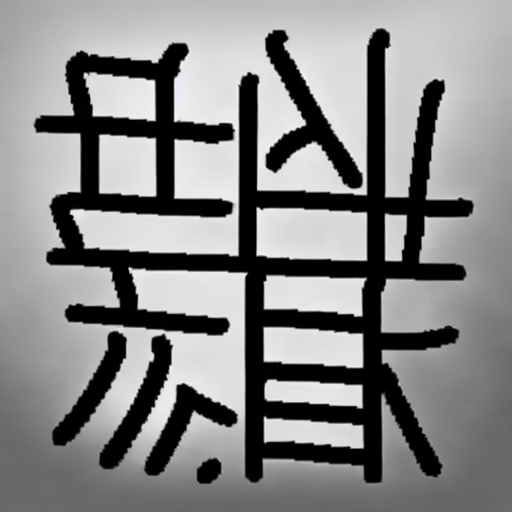

In [ ]:
prompt = "a kanji meaning Play Station 5"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

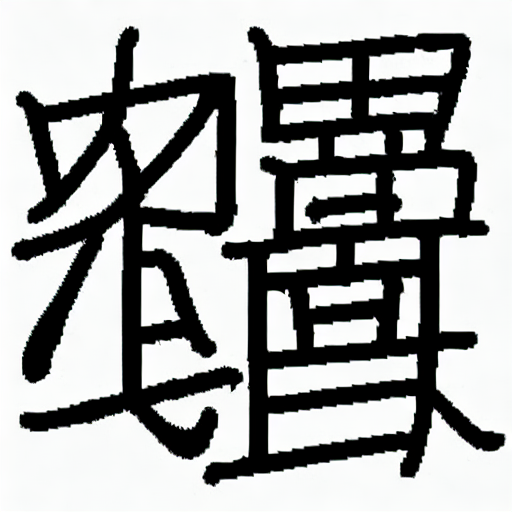

In [ ]:
prompt = "a kanji meaning Skyscraper"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

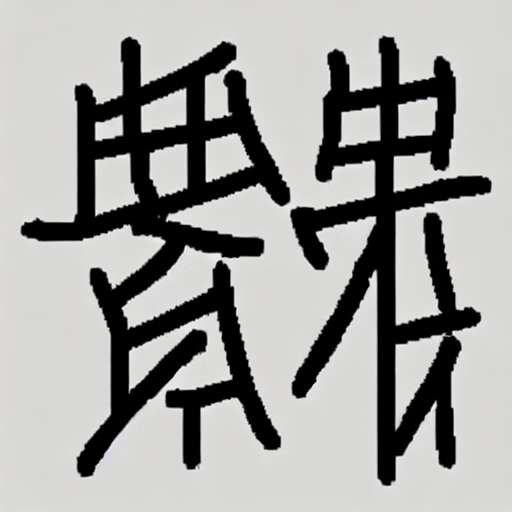

In [ ]:
prompt = "a kanji meaning Fish"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

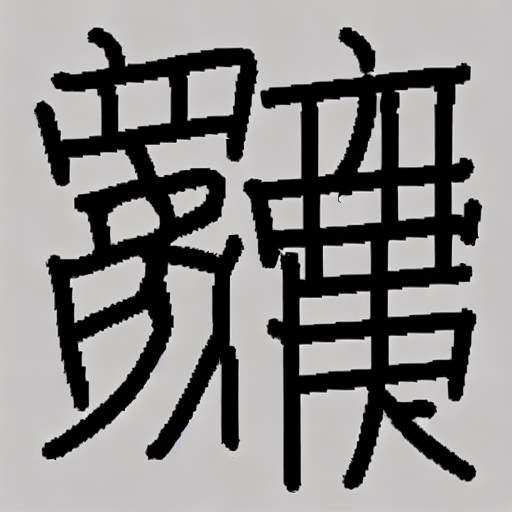

In [ ]:
prompt = "a kanji meaning shrimp"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

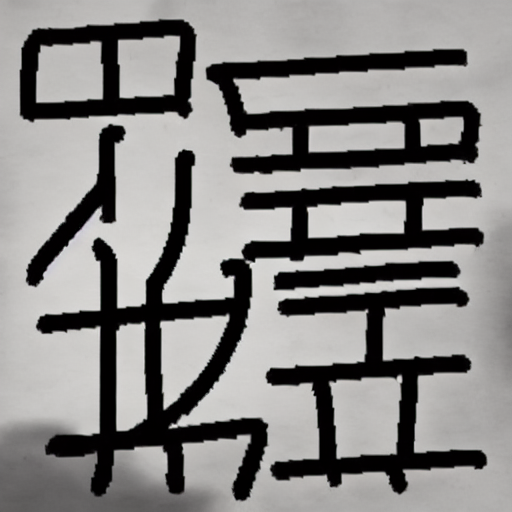

In [ ]:
prompt = "a kanji meaning global warming"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

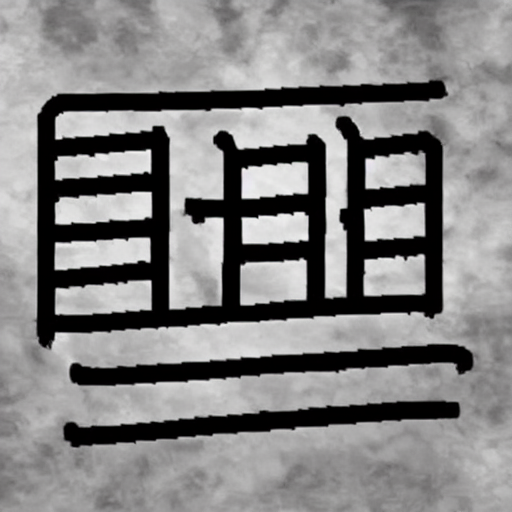

In [ ]:
prompt = "a kanji meaning robot army"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

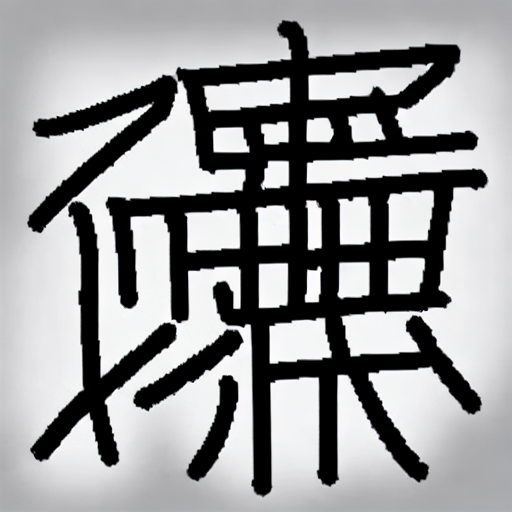

In [ ]:
prompt = "a kanji meaning bulletproof jelly"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

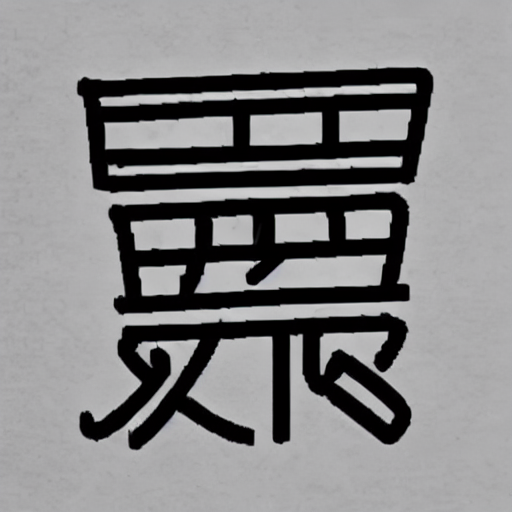

In [ ]:
prompt = "a kanji meaning Laptop"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

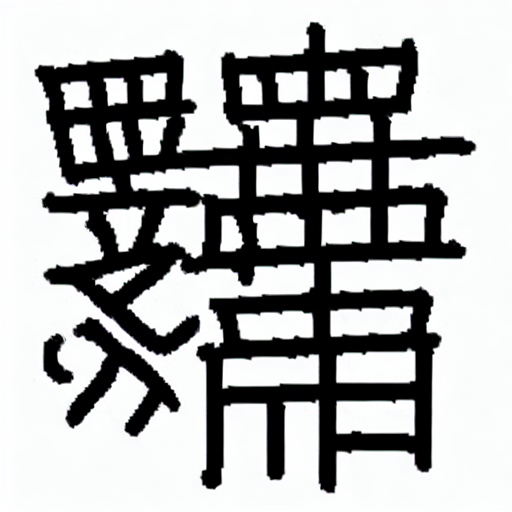

In [ ]:
prompt = "a kanji meaning Bharatanatyam (white background)"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

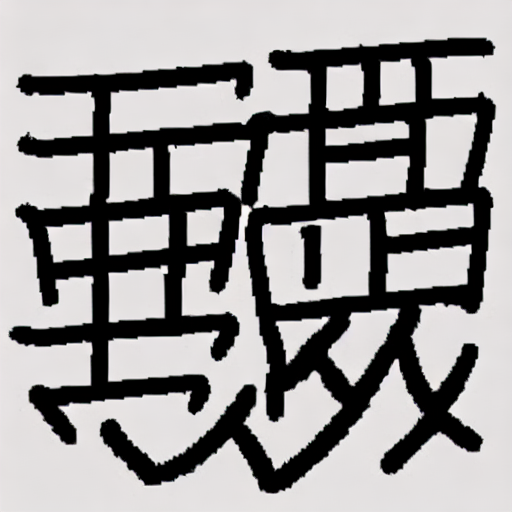

In [ ]:
prompt = "a kanji meaning Metal Mango"
generate_image(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

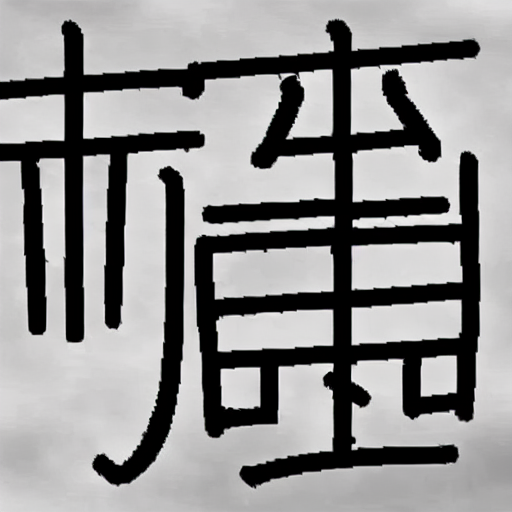

In [ ]:
prompt = "a kanji meaning Gundam"
generate_image(prompt, num_images=1)